In [1]:
import numpy as np
import pylab as mplot
%pylab inline

%pylab is deprecated, use %matplotlib inline and import the required libraries.
Populating the interactive namespace from numpy and matplotlib


In [2]:
kappa = np.load('../src/kappa.npz')['kappa']
y = np.load('../src/y.npz')['y']

kappa_z = np.load('../src/kappa.npz')['z']
y_z = np.load('../src/y.npz')['z']


In [3]:
kappa.shape, y.shape

((39, 64, 64), (64, 64))

In [4]:
print(kappa_z)
print(y_z)

[0.         0.06578947 0.13157895 0.19736842 0.26315789 0.32894737
 0.39473684 0.46052632 0.52631579 0.59210526 0.65789474 0.72368421
 0.78947368 0.85526316 0.92105263 0.98684211 1.05263158 1.11842105
 1.18421053 1.25       1.31578947 1.38157895 1.44736842 1.51315789
 1.57894737 1.64473684 1.71052632 1.77631579 1.84210526 1.90789474
 1.97368421 2.03947368 2.10526316 2.17105263 2.23684211 2.30263158
 2.36842105 2.43421053 2.5       ]
[0.0170409  0.05202906 0.08726866 0.12320323 0.15986591 0.19769998
 0.23575087 0.2746601  0.31447529 0.35524784 0.39703309 0.43989037
 0.48438886 0.52946102 0.57581076 0.62351451 0.67265384 0.72331581
 0.77559336 0.82958577 0.88539914 0.94370975 1.00337608 1.06521948
 1.12937808 1.19600021 1.26524542 1.33728551 1.41290766 1.490897
 1.57226141 1.65723246 1.74606145 1.83964289 1.93672158 2.03851612
 2.14537634 2.258245   2.37598876]


Text(0.5, 1.0, 'kappa @ z=2.5')

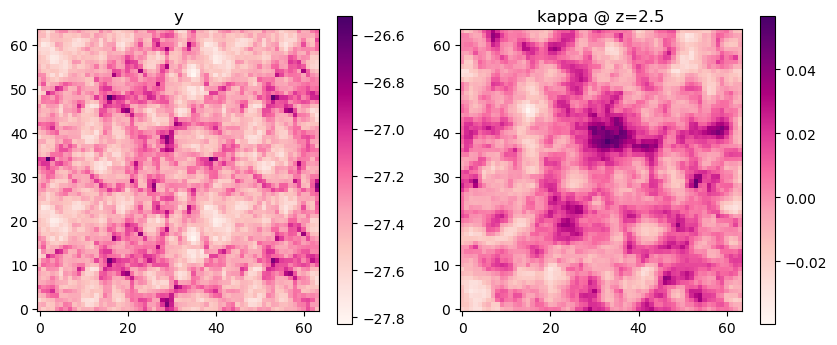

In [5]:

mplot.figure(figsize=(10,4))

mplot.subplot(121)
mplot.imshow(np.log10(y), origin='lower', cmap='RdPu')
mplot.colorbar()
mplot.title('y')

mplot.subplot(122)
mplot.imshow(kappa[-1], origin='lower', cmap='RdPu')
mplot.colorbar()
mplot.title('kappa @ z='+str(kappa_z[-1])[:4])


In [ ]:
mplot.figure(figsize=(15,20))
for i in range(39):
    mplot.subplot(8,5,i+1)
    mplot.imshow(kappa[i])
    mplot.colorbar()
    mplot.title('kappa @ z='+str(kappa_z[i])[:4])
mplot.tight_layout()

In [7]:
res = np.load('../src/intermediate/res.npz')['res']

In [8]:
moved_1 = np.load('../src/intermediate/moved_res_0.npz')['res']
moved_2 = np.load('../src/intermediate/moved_res_30.npz')['res']

In [9]:
# print(moved_1)

In [10]:
res.shape

(2, 40, 5242880, 3)

In [11]:
res[0].shape

(40, 5242880, 3)

In [12]:
moved_1.shape

(5242879, 3)

In [13]:
x = res[0][0, :, 0]
y = res[0][0, :, 1]
z = res[0][0, :, 2]

x_move = moved_1[:, 0]
y_move = moved_1[:, 1]
z_move = moved_1[:, 2]

In [14]:
# print(z)

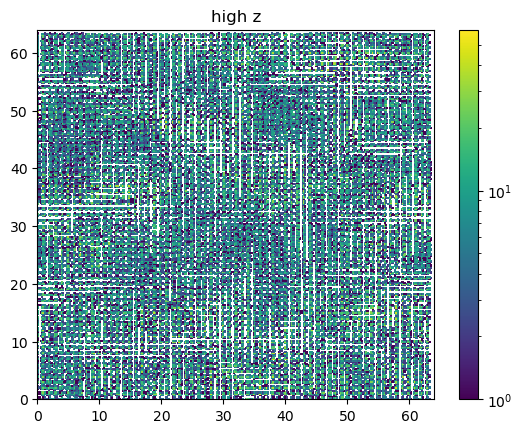

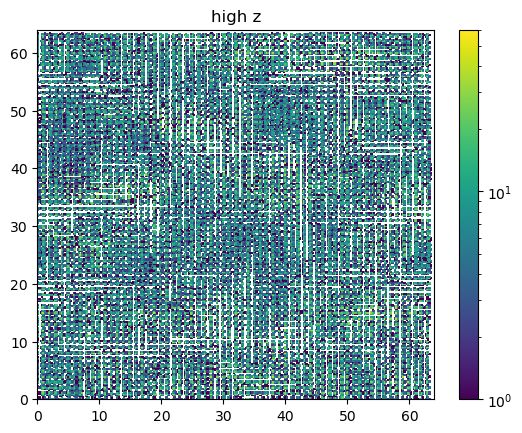

In [15]:
mplot.figure()
mask = (z>100)*(z<200)
mplot.hist2d(x[mask], y[mask], range=((0,64),(0,64)), bins=(300,300), norm=mpl.colors.LogNorm())
mplot.title('high z')
mplot.colorbar()

mplot.figure()
mask = (z_move>100)*(z_move<200)
mplot.hist2d(x_move[mask], y_move[mask], range=((0,64),(0,64)), bins=(300,300),norm=mpl.colors.LogNorm())
mplot.title('high z')
mplot.colorbar()

In [16]:
x = res[0][36, :, 0]
y = res[0][36, :, 1]
z = res[0][36, :, 2]


x_move = moved_2[:, 0]
y_move = moved_2[:, 1]
z_move = moved_2[:, 2]

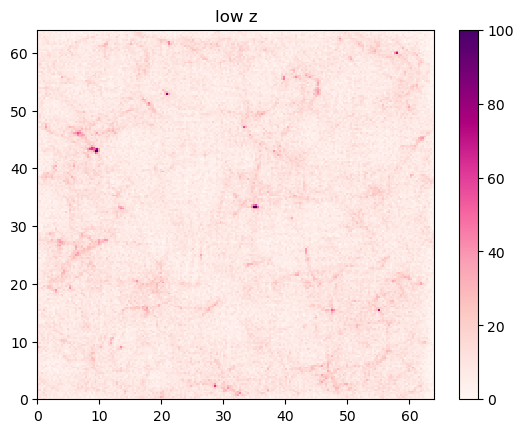

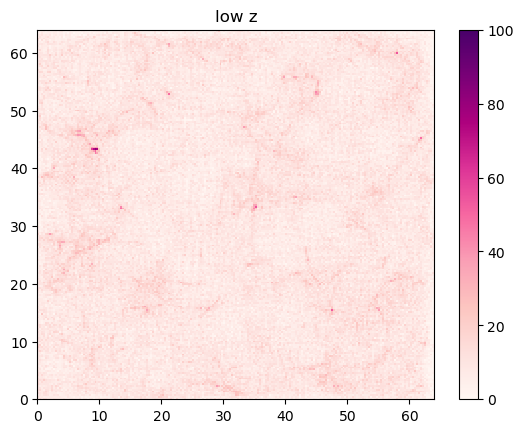

In [17]:
mplot.figure()
mask = (z>100)*(z<200)
mplot.hist2d(x[mask], y[mask], range=((0,64),(0,64)), bins=(200,200), cmap='RdPu')
mplot.title('low z')
mplot.colorbar()
mplot.clim(0,100)
mplot.figure()
mask = (z_move>100)*(z_move<200)
mplot.hist2d(x_move[mask], y_move[mask], range=((0,64),(0,64)), bins=(200,200),cmap='RdPu')
mplot.title('low z')
mplot.colorbar()
mplot.clim(0,100)

In [ ]:
res = np.load('../src/intermediate/res.npz')['res']


/var/folders/mc/gj6kz6750g7dks2k81t8xyl80000gn/T/ipykernel_29819/288519094.py:20: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
  mplot.figure(figsize=(15,3))


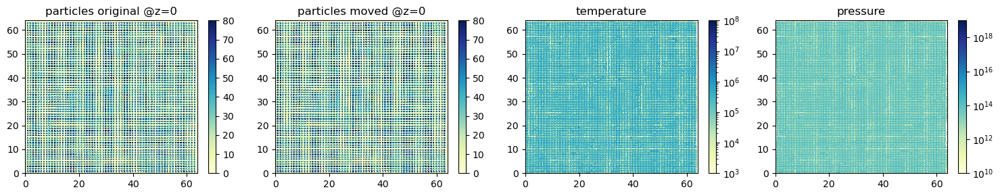

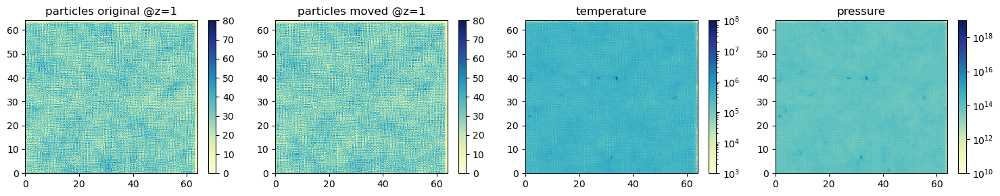

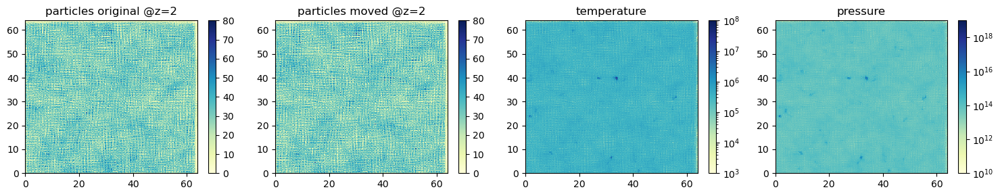

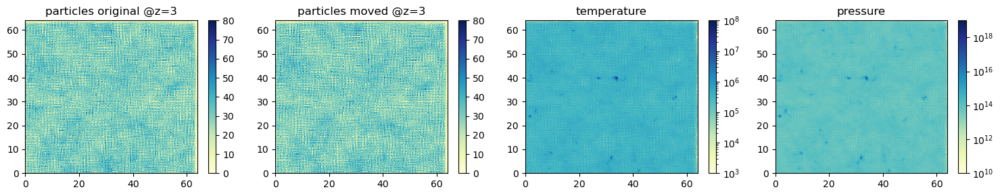

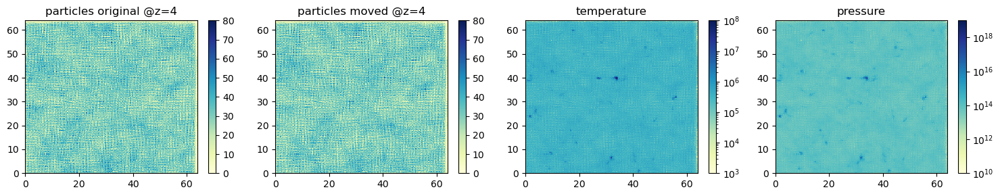

...

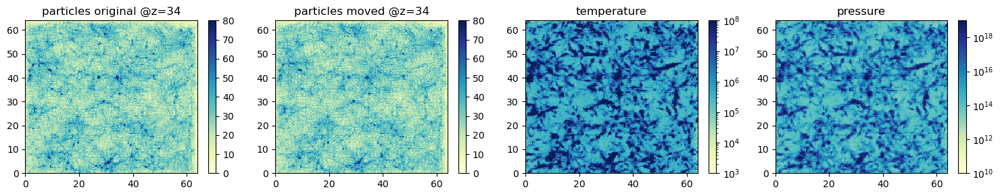

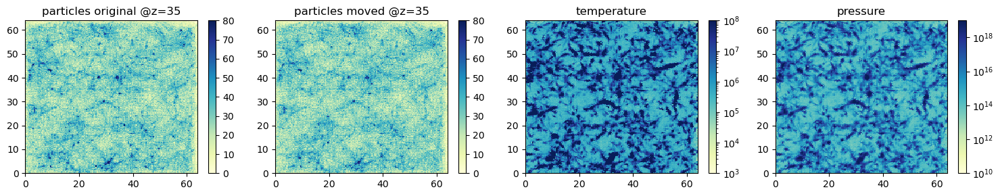

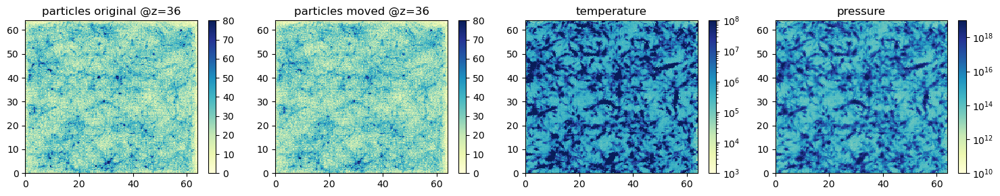

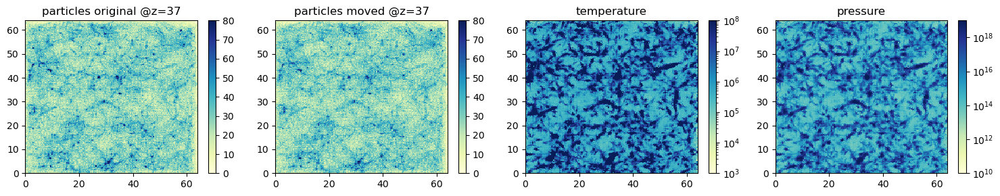

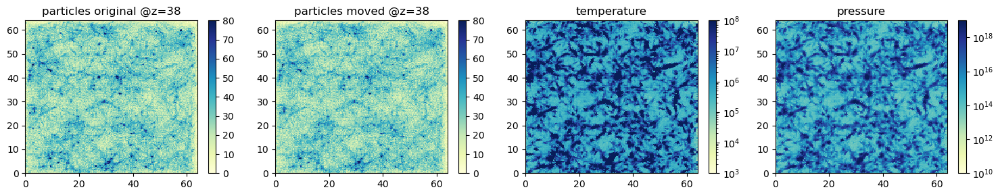

In [47]:

for i in range(39):
    res0 = res[0][i]
    moved = np.load('../src/intermediate/moved_res_'+str(i)+'.npz')['res']
    T = np.load('../src/intermediate/TP_'+str(i)+'.npz')['T']
    P = np.load('../src/intermediate/TP_'+str(i)+'.npz')['P']
    
    x = res0[:, 0]
    y = res0[:, 1]
    z = res0[:, 2]
    mask = (z<300)


    x_move = moved[:, 0]
    y_move = moved[:, 1]
    z_move = moved[:, 2]
    mask_move = (z_move<300)
    
#     print(len(x_move), len(T))
    
    mplot.figure(figsize=(15,3))

    mplot.subplot(141)
    mplot.hist2d(x[mask], y[mask], range=((0,64),(0,64)), bins=(200,200), cmap='YlGnBu')
    mplot.title('particles original @z='+str(i))
    mplot.colorbar()
    mplot.clim(0,80)

    mplot.subplot(142)
    mplot.hist2d(x_move[mask_move], y_move[mask_move], range=((0,64),(0,64)), bins=(200,200), cmap='YlGnBu')
    mplot.title('particles moved @z='+str(i))
    mplot.colorbar()
    mplot.clim(0,80)

    mplot.subplot(143)
    mplot.hist2d(x_move[mask_move], y_move[mask_move], weights=T[mask_move], range=((0,64),(0,64)), bins=(200,200), cmap='YlGnBu',norm=mpl.colors.LogNorm())
    mplot.title('temperature')
    mplot.colorbar()
    mplot.clim(1e3,1e8)

    mplot.subplot(144)
    mplot.hist2d(x_move[mask_move], y_move[mask_move], weights=P[mask_move], range=((0,64),(0,64)), bins=(200,200), cmap='YlGnBu',norm=mpl.colors.LogNorm())
    mplot.title('pressure')
    mplot.colorbar()
    mplot.clim(1e10,1e19)
    
    mplot.tight_layout()

    savefig('temp_fig/density_t_p_'+str(i)+'.jpg')


In [48]:
import glob
from PIL import Image
def make_gif(frame_folder):
    frames = [Image.open("temp_fig/density_t_p_"+str(i)+".jpg") for i in range(39)]
    frame_one = frames[0]
    frame_one.save("density_t_p.gif", format="GIF", append_images=frames,
               save_all=True, duration=150, loop=1)
    
if __name__ == "__main__":
    make_gif("temp_fig")

In [ ]:
# movie evolving same z slab from low redshift to high redshift
# then move EGD
# then turn into pressure

In [ ]:

# movie of kappa as a function of z
# movie of y as a function of integrated distance